In [2]:
from sys import path
path.append('../src/')

import numpy as np
import pickle as pkl
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.layers import GlobalAvgPool2D
from keras.models import load_model, Model
from scipy.spatial.distance import cdist
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from global_config import FILE_DUMP_IMAGES, FILE_DUMP_MRKS
from mrk_file import MRKFile
from utils import plot

%matplotlib inline

Using TensorFlow backend.


In [3]:
FILE_BASE_MODEL = '../models/autoencoders_unsupervised/model_2020_03_15-10_43_27.h5'

In [27]:
def plot_pca(embeddings_2d, y):
    plt.figure(figsize=(6, 6))
    plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], s=1, c=y, cmap='bwr')
    plt.show()

def get_reference_image(x, y, idx=None):
    images_nc = x[y == 0]

    random_idx = np.random.choice(range(images_nc.shape[0]), size=1)
    random_idx = random_idx if idx is None else [idx]
    print('random index:', random_idx)
    img_ref = images_nc[random_idx]

    plt.figure(figsize=(6, 6))
    plt.imshow(img_ref.squeeze()[:, :, ::-1].astype(np.uint8))
    plt.axis('off')
    plt.show()
    
    return img_ref 

def plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, n_cols=5, figsize=(16, 20)):
    emb_ref = encoder.predict(img_ref / 255)

    distances = cdist(emb_ref, embeddings).squeeze()
    closest_idxs = np.argsort(distances)[1:n_imgs+1] # from 1 because the img in 0 is the reference image itself
    closest_imgs = x[closest_idxs][:, :, :, ::-1]
    closest_pred = y[closest_idxs]

    print(distances[closest_idxs])
    plot.image_batch(closest_imgs, closest_pred, n_cols=n_cols, figsize=figsize)

# Load Data

In [10]:
x, _ = pkl.load(open(FILE_DUMP_IMAGES, 'rb'))
mrks, _ = pkl.load(open(FILE_DUMP_MRKS, 'rb'))

print(x.shape, x.dtype)
print(mrks.shape, mrks.dtype)

(5763, 224, 224, 3) float32
(5763,) object


# Load Model

In [11]:
model = load_model(FILE_BASE_MODEL)

embeddings = GlobalAvgPool2D(name='embeddings')(model.get_layer(name='encoded').output)

encoder = Model(inputs=model.inputs, outputs=embeddings)
encoder.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 224, 224, 3)       0         
_________________________________________________________________
conv_1 (Conv2D)              (None, 224, 224, 16)      448       
_________________________________________________________________
bn_1 (BatchNormalization)    (None, 224, 224, 16)      64        
_________________________________________________________________
relu_1 (Activation)          (None, 224, 224, 16)      0         
_________________________________________________________________
pool_1 (MaxPooling2D)        (None, 112, 112, 16)      0         
_________________________________________________________________
conv_2 (Conv2D)              (None, 112, 112, 32)      4640      
_________________________________________________________________
bn_2 (BatchNormalization)    (None, 112, 112, 32)      128 

# Autoencoder as a Recommendation/Recognition System 

In [12]:
embeddings = encoder.predict(x / 255)
print(embeddings.shape)

(5763, 256)


In [13]:
pca = PCA(n_components=2)
emb_2d = pca.fit_transform(embeddings)

print(emb_2d.shape)
print(emb_2d.min(), emb_2d.max())

(5763, 2)
-4.7415023 6.8374147


## Blurred

one of the best results

(5763,)
(array([0, 1]), array([ 905, 4858], dtype=int64))


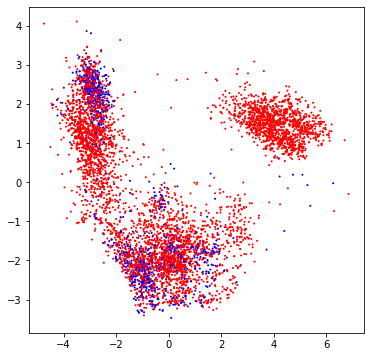

In [14]:
y = np.array([mrk.photo_reqs.blurred.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

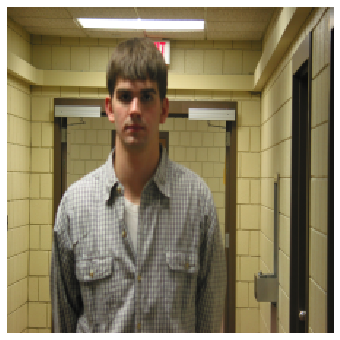

In [21]:
img_ref = get_reference_image(x, y)

[0.0623462  1.05119499 1.09018373 1.27404872 1.33470803 1.36360639
 1.40699019 1.40965876 1.41376219 1.41388281 1.41450312 1.42425454
 1.43935463 1.43981426 1.4403646  1.44508437 1.44607587 1.44809079
 1.45717278 1.47482505]


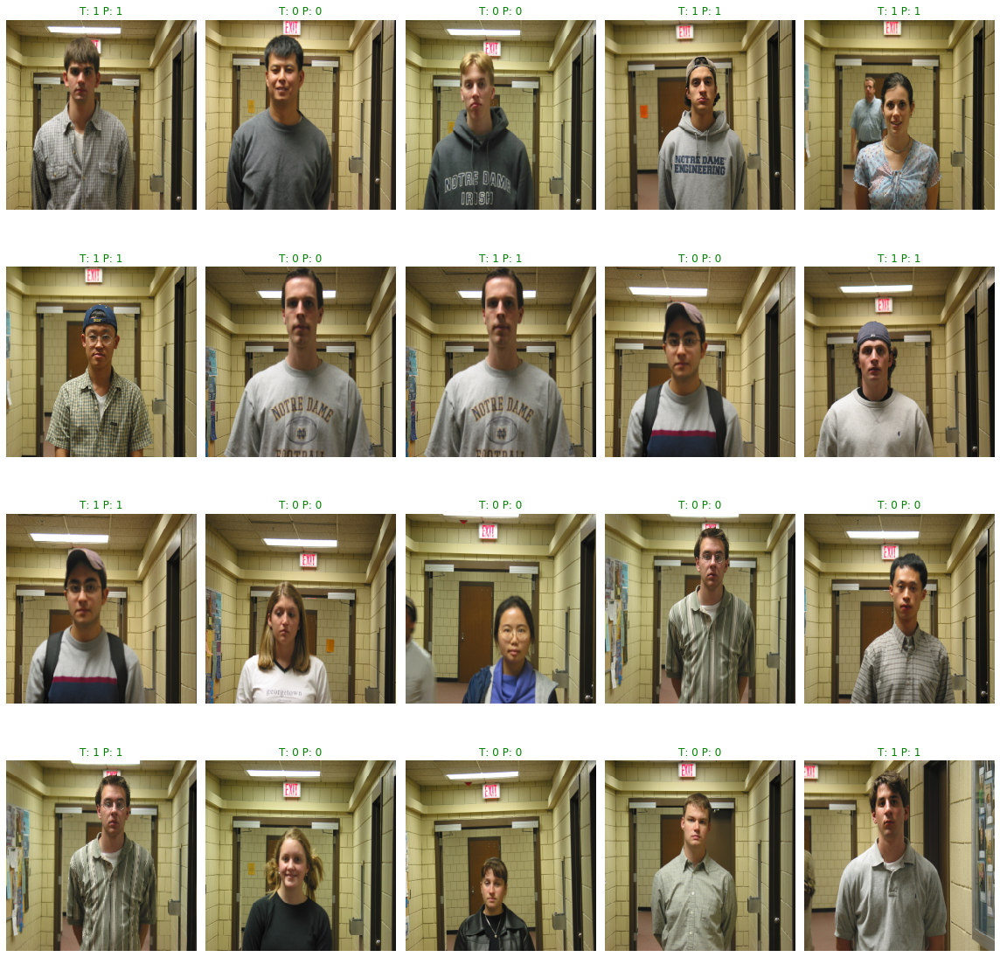

In [22]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Looking Away

(5763,)
(array([0, 1]), array([1817, 3946], dtype=int64))


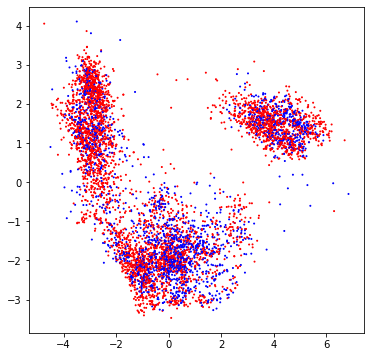

In [24]:
y = np.array([mrk.photo_reqs.looking_away.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [671]


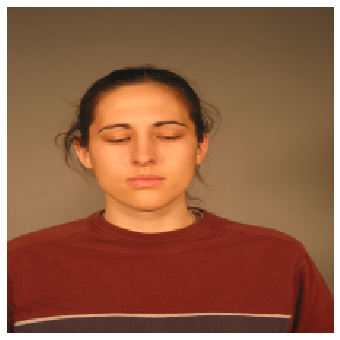

In [30]:
img_ref = get_reference_image(x, y)

[0.78797013 1.0443095  1.05434767 1.07015977 1.11627193 1.17282814
 1.20743943 1.20909161 1.21720909 1.2355043  1.25200033 1.28200429
 1.29326772 1.30600543 1.33941922 1.3621425  1.38059317 1.42382377
 1.43381209 1.43800488]


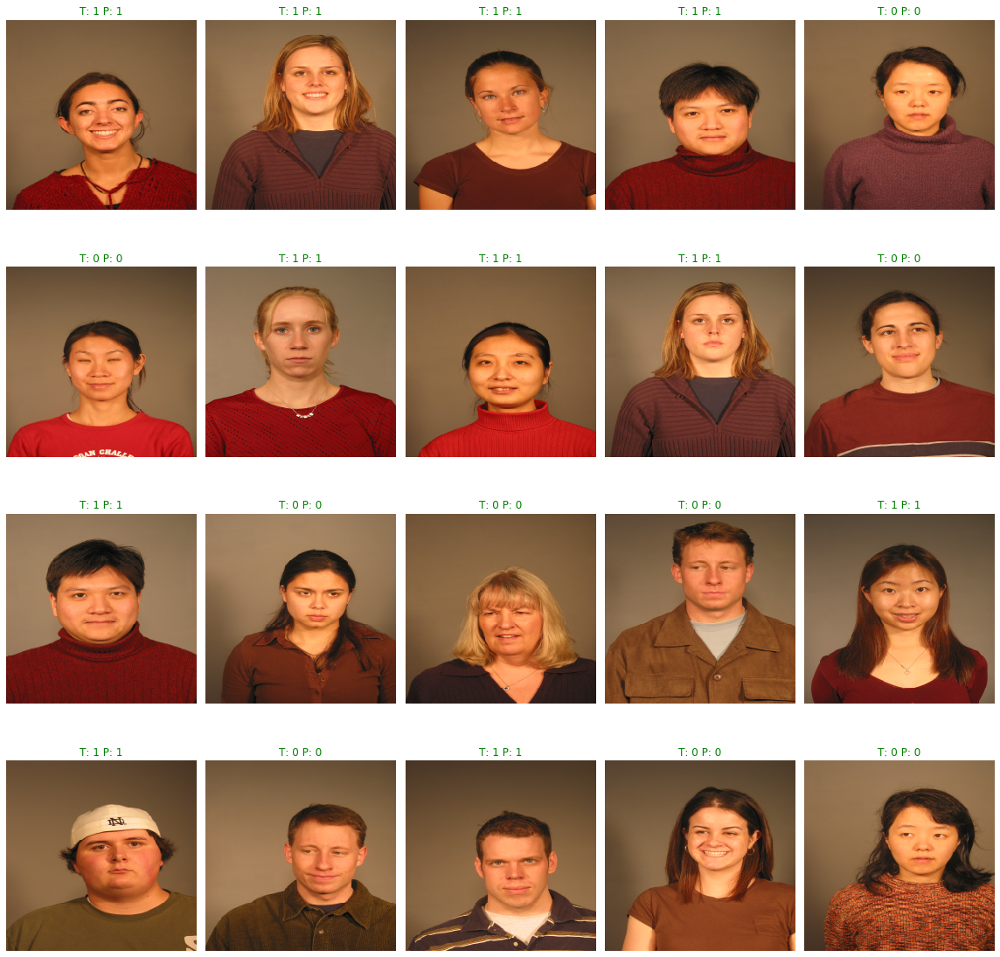

In [31]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Ink Marked/Creased

one of the worst results

(5763,)
(array([0, 1]), array([  21, 5742], dtype=int64))


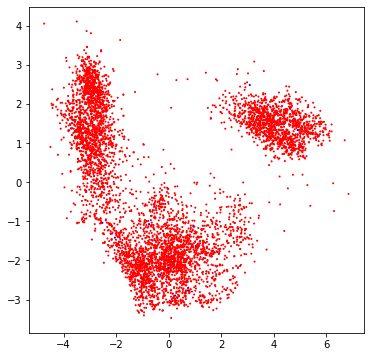

In [32]:
y = np.array([mrk.photo_reqs.ink_marked_creased.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [1]


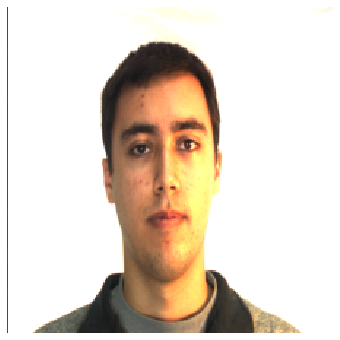

In [33]:
img_ref = get_reference_image(x, y)

[0.56296336 0.61403861 0.62672351 0.64023679 0.65642162 0.66326313
 0.67274034 0.67985352 0.68088592 0.68683336 0.69117081 0.70483461
 0.70520664 0.71419125 0.71457373 0.72372896 0.72434846 0.72615002
 0.72654844 0.73062068]


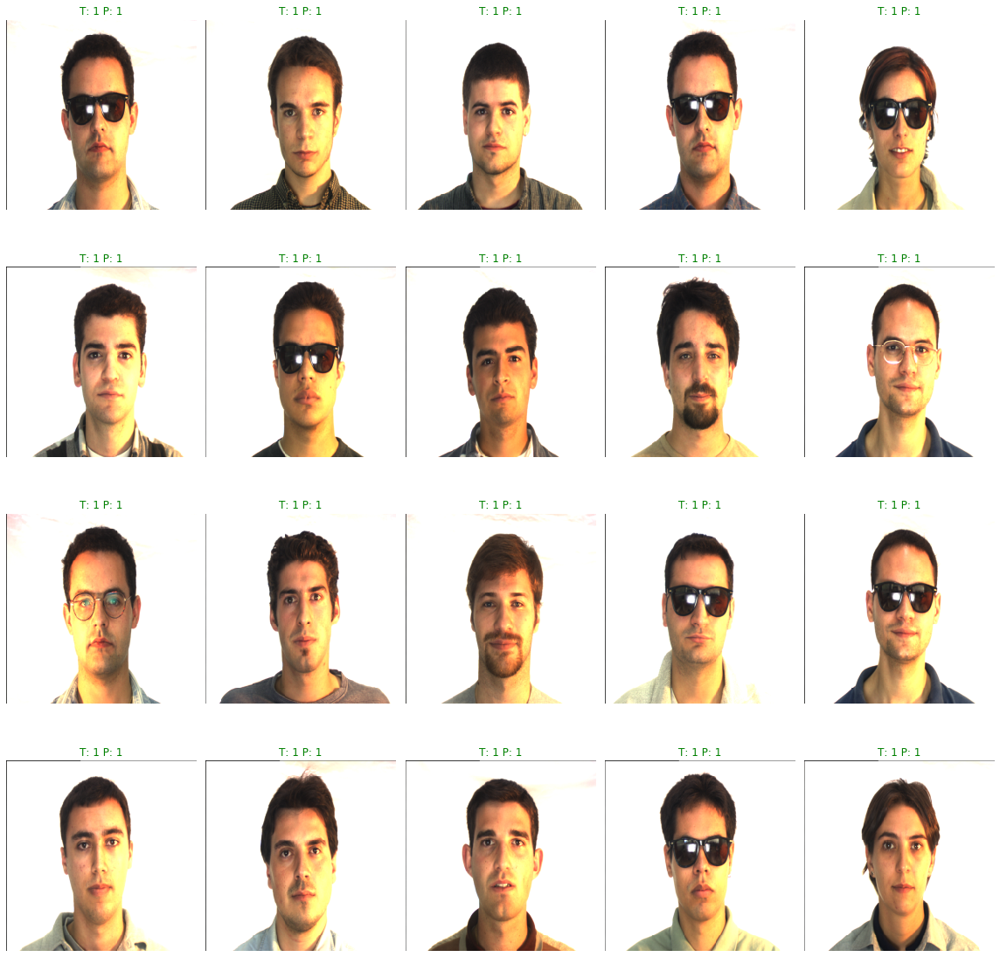

In [34]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Unnatural Skin Tone

(5763,)
(array([0, 1]), array([3223, 2540], dtype=int64))


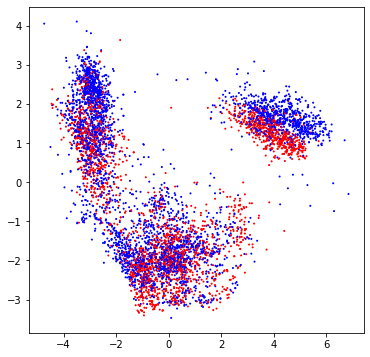

In [35]:
y = np.array([mrk.photo_reqs.unnatural_skin_tone.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [132]


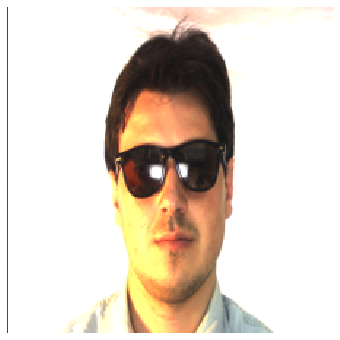

In [36]:
img_ref = get_reference_image(x, y)

[0.45379579 0.56020114 0.59155552 0.61957066 0.62636001 0.64779813
 0.65238926 0.65883825 0.66478786 0.66543372 0.66703238 0.68037473
 0.68448989 0.68566741 0.68803955 0.68927925 0.69653902 0.72362762
 0.72405953 0.7274953 ]


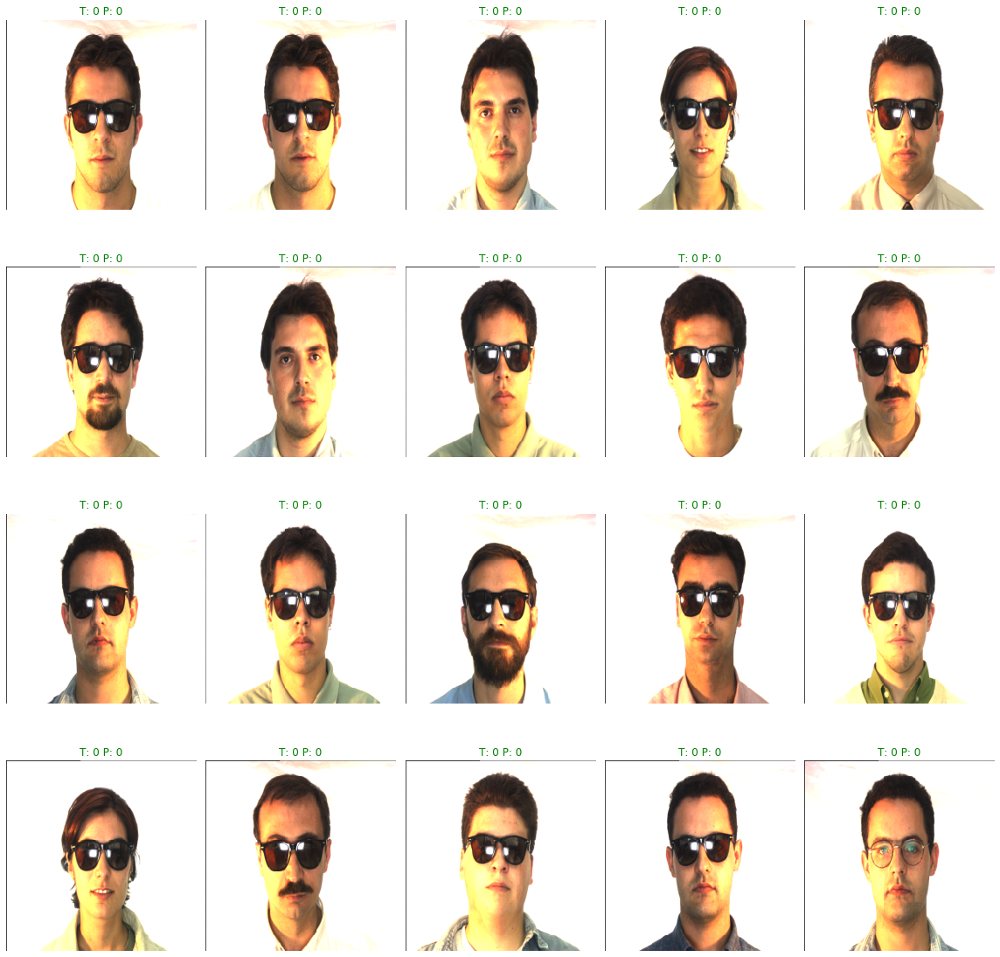

In [37]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Too Dark/Light 

one of the best results

(5763,)
(array([0, 1]), array([ 456, 5307], dtype=int64))


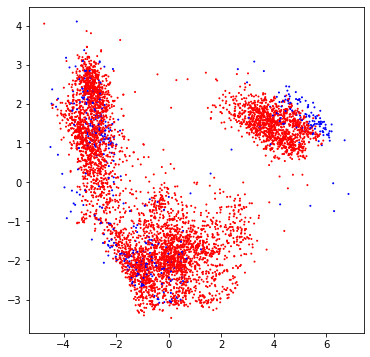

In [8]:
y = np.array([mrk.photo_reqs.too_dark_light.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

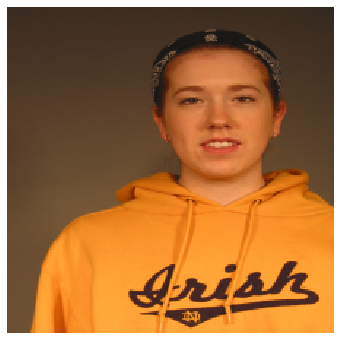

In [9]:
img_ref = get_reference_image(x, y)

[1.46028952 1.66152294 1.78845778 1.82078123 1.83183698 1.93279383
 2.00457092 2.0224265  2.04748265 2.05399683 2.10480806 2.15263878
 2.17906417 2.19260401 2.21856596 2.25177834 2.25293804 2.27312594
 2.31060227 2.31560325]


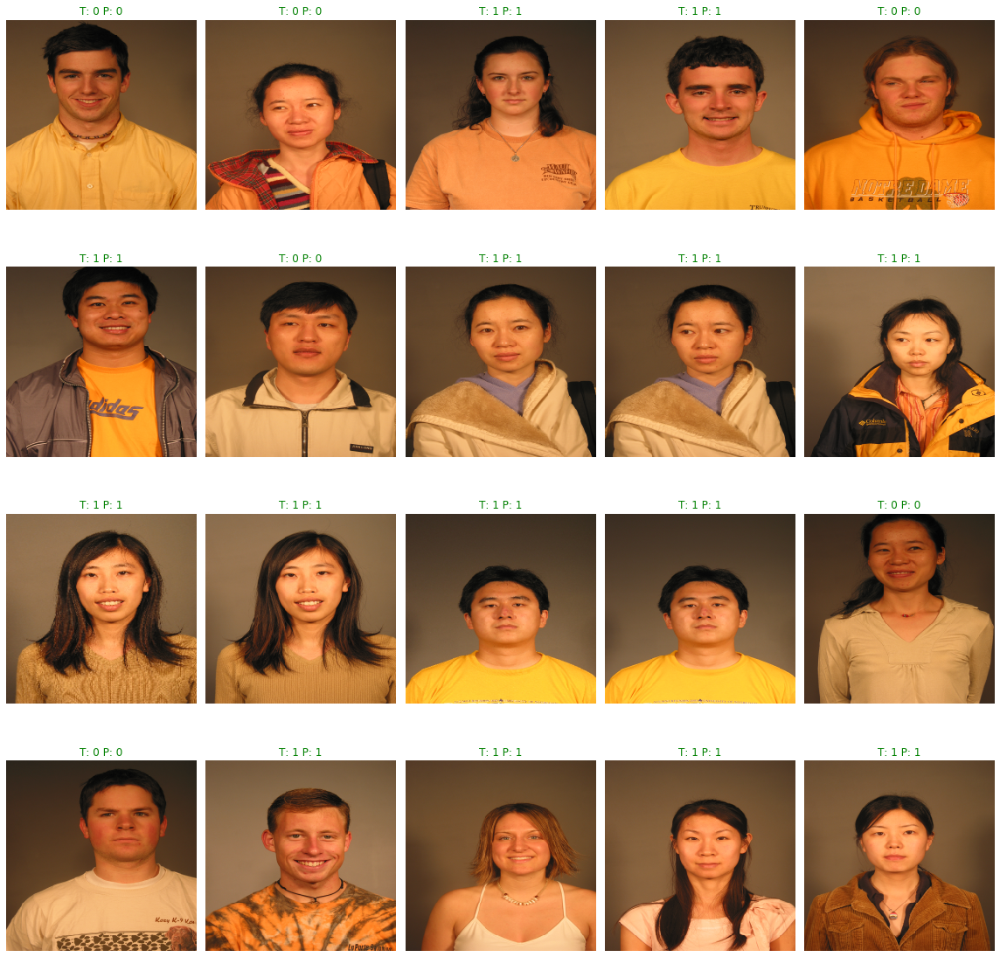

In [10]:
plot_closest_images(img_ref, encoder, x, y, embeddings)

## Washed Out

one of the best results

(5763,)
(array([0, 1]), array([  73, 5690], dtype=int64))


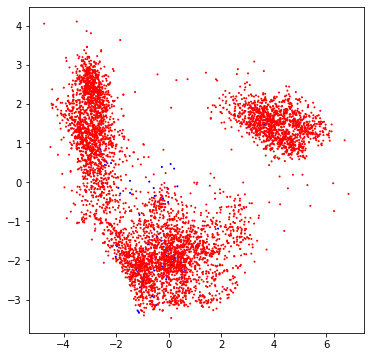

In [14]:
y = np.array([mrk.photo_reqs.washed_out.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

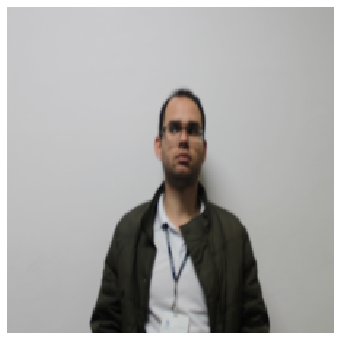

In [17]:
img_ref = get_reference_image(x, y)

[0.28125958 0.6061483  0.6267275  0.63721468 0.65229994 0.66035609
 0.66342587 0.66978603 0.67197408 0.67946731 0.68175696 0.68262477
 0.68317569 0.68856176 0.70675392 0.71143457 0.7146842  0.71589255
 0.72744885 0.72848917]


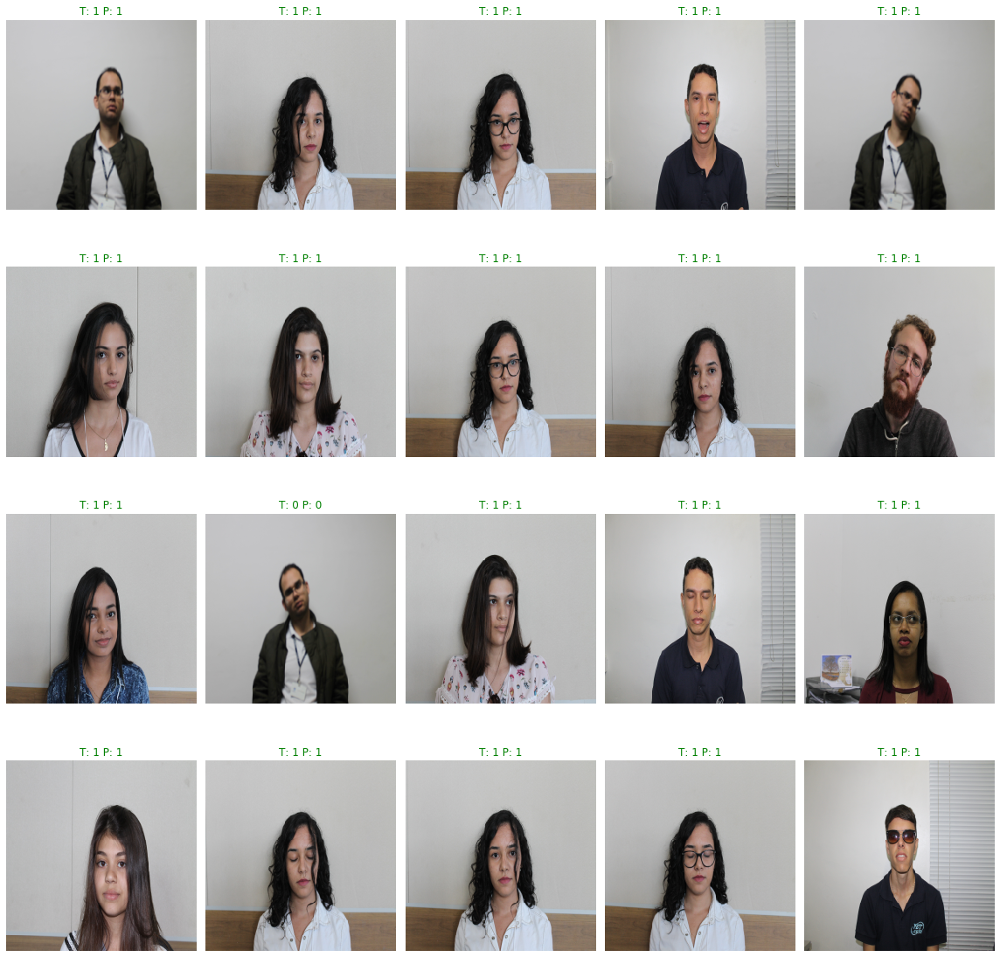

In [18]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Pixelation

(5763,)
(array([0, 1]), array([ 397, 5366], dtype=int64))


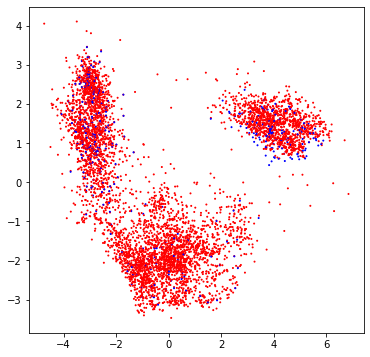

In [38]:
y = np.array([mrk.photo_reqs.pixelation.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [387]


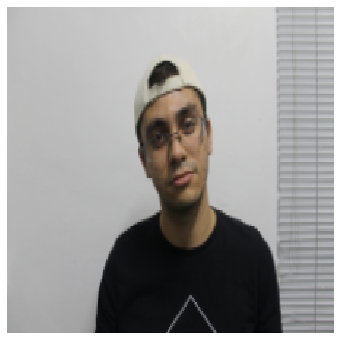

In [39]:
img_ref = get_reference_image(x, y)

[0.18217149 0.52103758 0.53000929 0.55691291 0.58018144 0.61110138
 0.6171434  0.61763939 0.65859402 0.66232891 0.66837381 0.67591159
 0.68163488 0.6856556  0.69513377 0.70194126 0.70667934 0.70870993
 0.71190801 0.72371652]


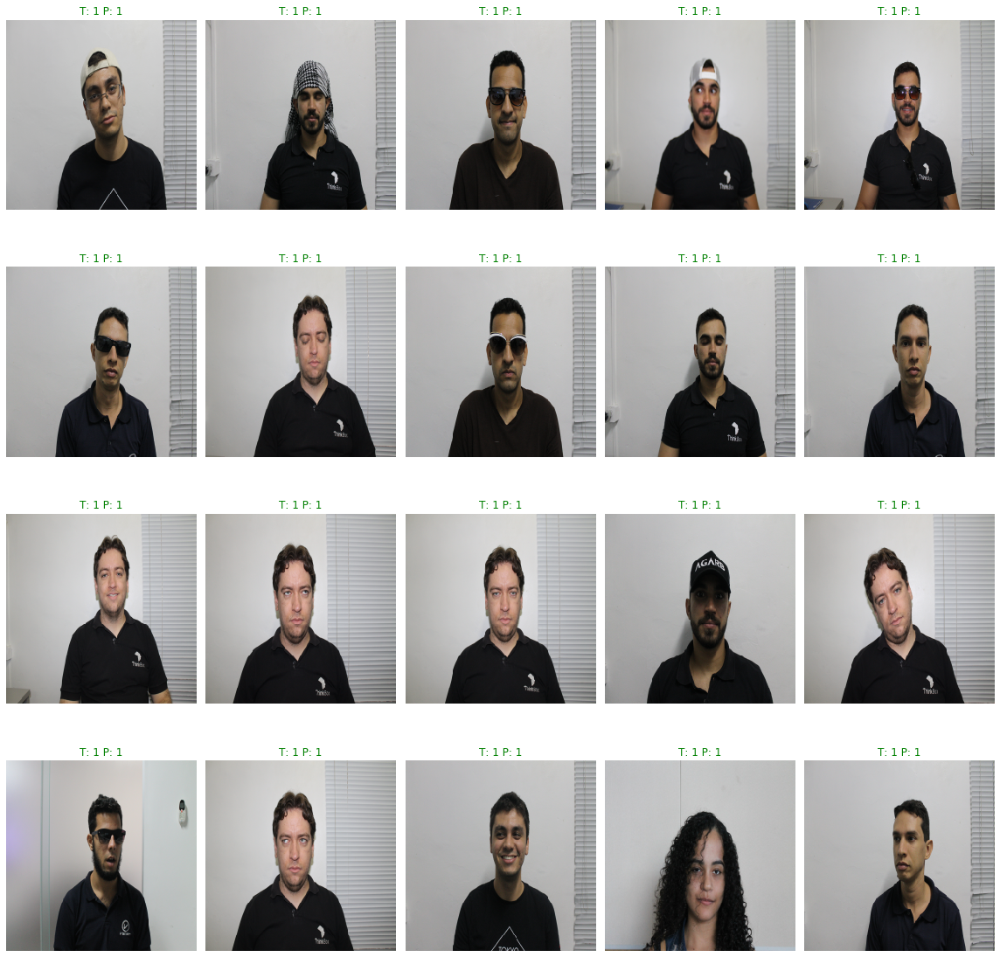

In [40]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Hair Across Eyes

(5763,)
(array([0, 1]), array([1511, 4252], dtype=int64))


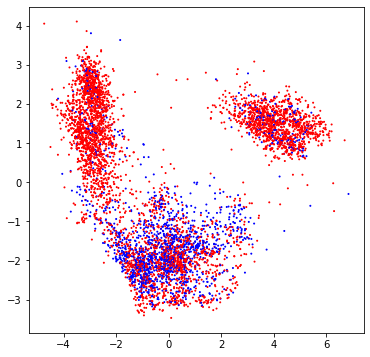

In [41]:
y = np.array([mrk.photo_reqs.hair_across_eyes.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [1191]


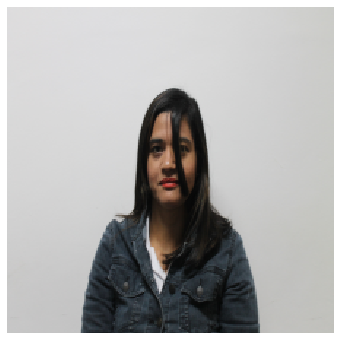

In [42]:
img_ref = get_reference_image(x, y)

[0.27870853 0.30656571 0.37104809 0.40405387 0.41151818 0.42483899
 0.56031415 0.56984391 0.58594432 0.59723278 0.62173455 0.66335468
 0.6654596  0.66793491 0.6823276  0.68877954 0.69891576 0.71463266
 0.71585405 0.71754967]


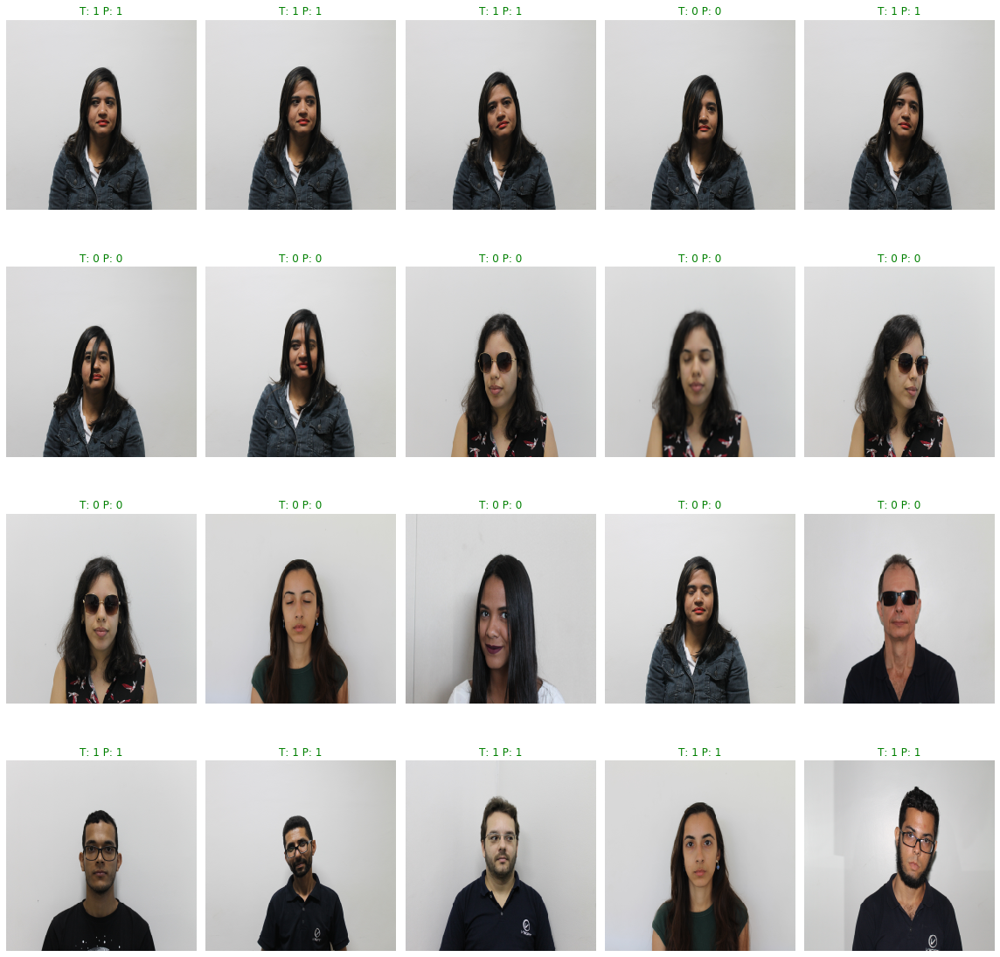

In [43]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Eyes closed

one of the worst results

(5763,)
(array([0, 1]), array([1323, 4440], dtype=int64))


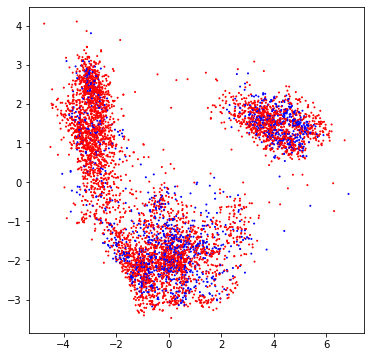

In [36]:
y = np.array([mrk.photo_reqs.eyes_closed.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

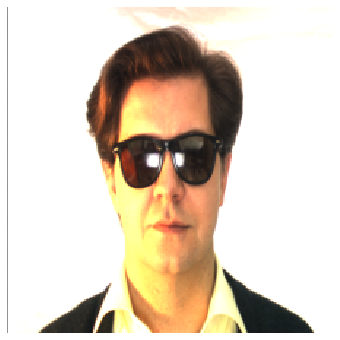

In [37]:
img_ref = get_reference_image(x, y)

[0.52638946 0.5315028  0.72292321 0.81664262 0.81822468 0.82385846
 0.82446088 0.84852637 0.89238592 0.91342288 0.91812762 0.92196131
 0.92833077 0.93093654 0.95185307 0.95373188 0.97374426 0.98076237
 0.98542207 0.99008165]


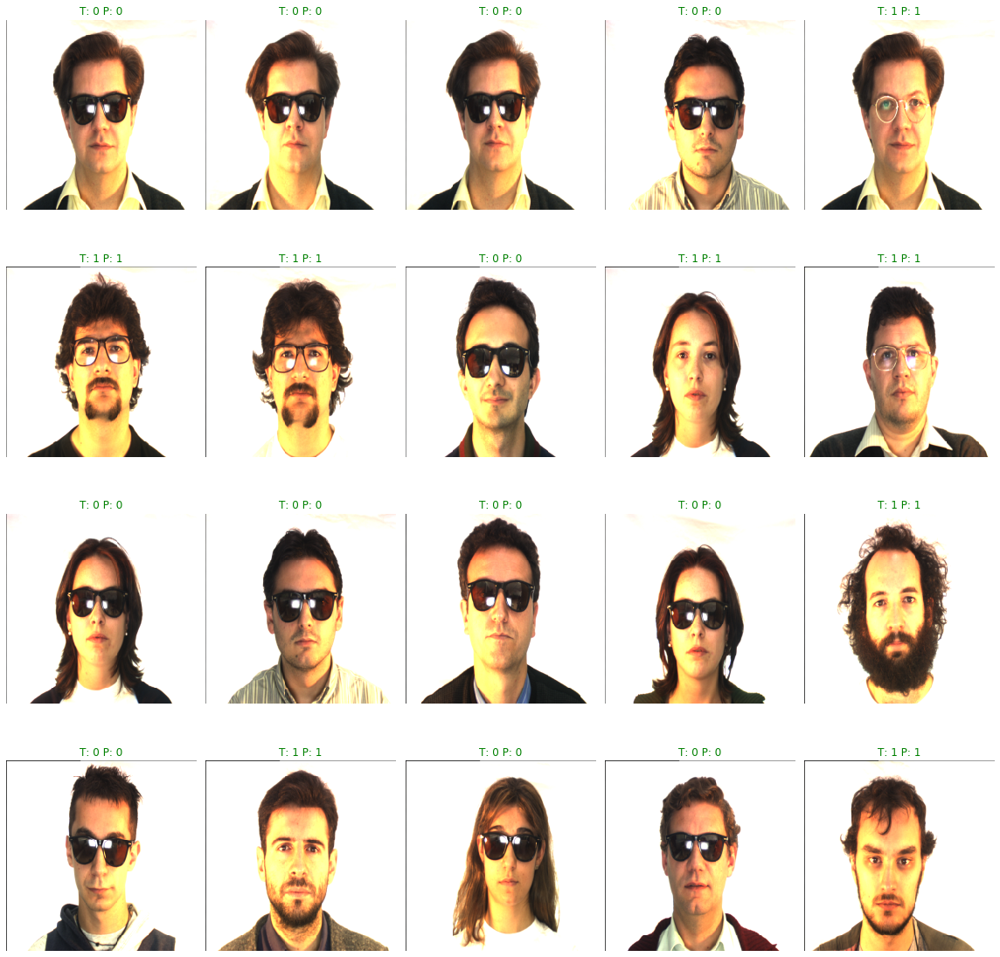

In [38]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Varied Background

(5763,)
(array([0, 1]), array([2515, 3248], dtype=int64))


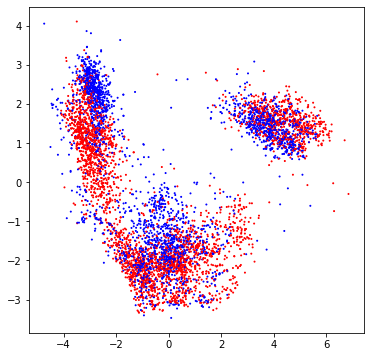

In [44]:
y = np.array([mrk.photo_reqs.varied_background.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [314]


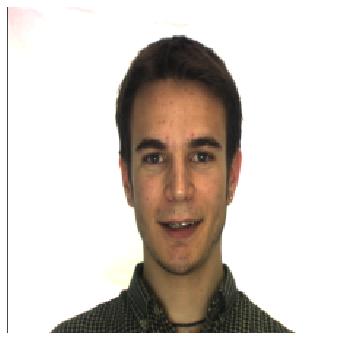

In [45]:
img_ref = get_reference_image(x, y)

[2.16423416e-06 4.45154166e-01 5.12415726e-01 5.44818373e-01
 5.74106162e-01 5.86676118e-01 6.13671764e-01 6.14534189e-01
 6.14739749e-01 6.18320731e-01 6.37633290e-01 6.42425504e-01
 6.53354441e-01 6.71841975e-01 6.71841975e-01 6.74363075e-01
 6.78820958e-01 6.87474955e-01 6.88276394e-01 6.97043046e-01]


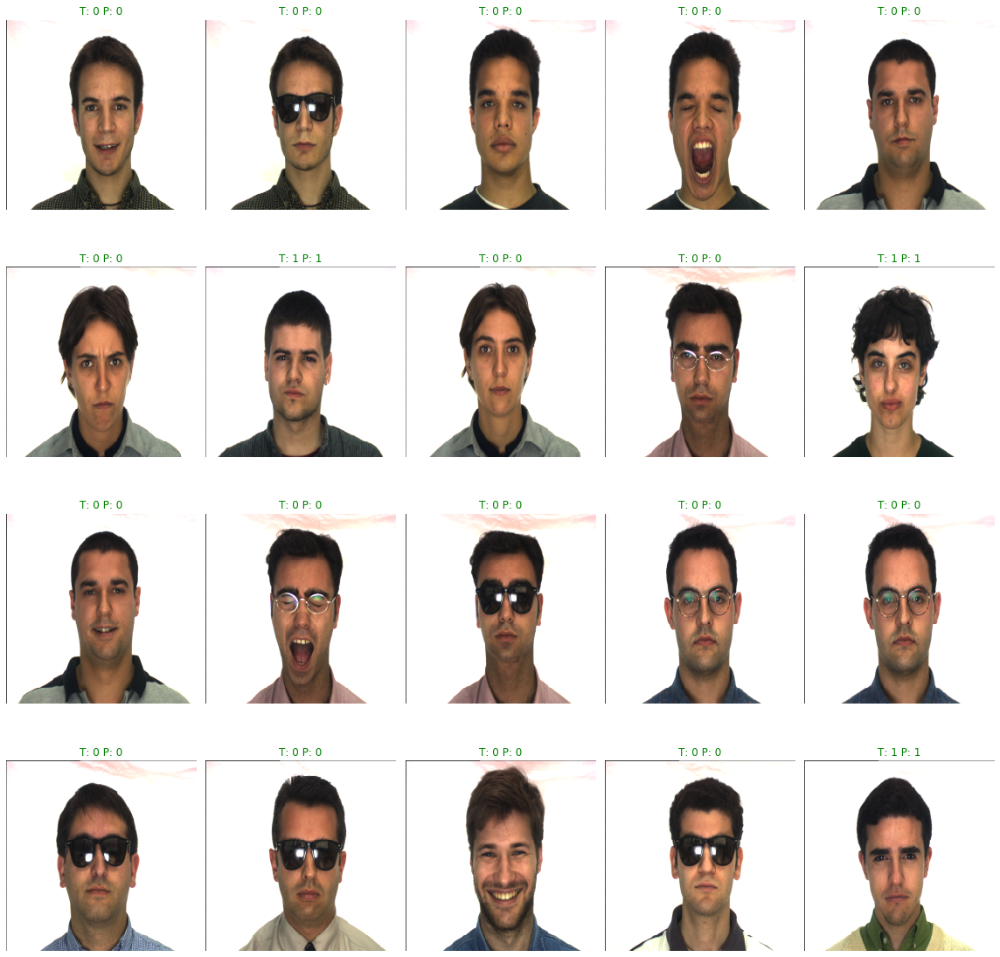

In [46]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Roll/Pitch/Yaw 

(5763,)
(array([0, 1]), array([1416, 4347], dtype=int64))


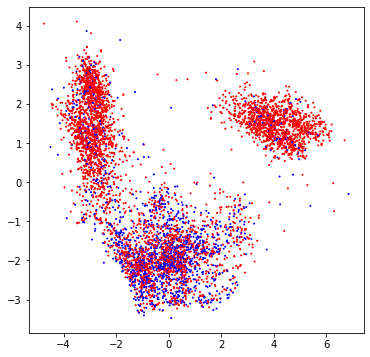

In [30]:
y = np.array([mrk.photo_reqs.roll_pitch_yaw.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

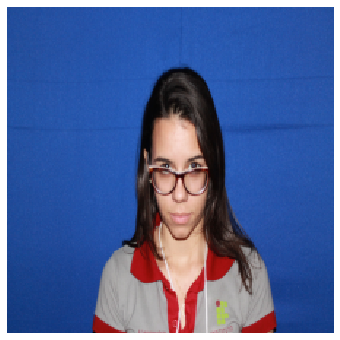

In [34]:
img_ref = get_reference_image(x, y)

[0.43558902 0.73673722 0.74451354 0.83820036 0.84505347 0.87569244
 0.89399623 0.91834149 0.9190288  0.93156669 0.94317342 0.95413327
 0.96562373 0.9836148  1.0065252  1.01293441 1.01362911 1.0211694
 1.04634026 1.0476851 ]


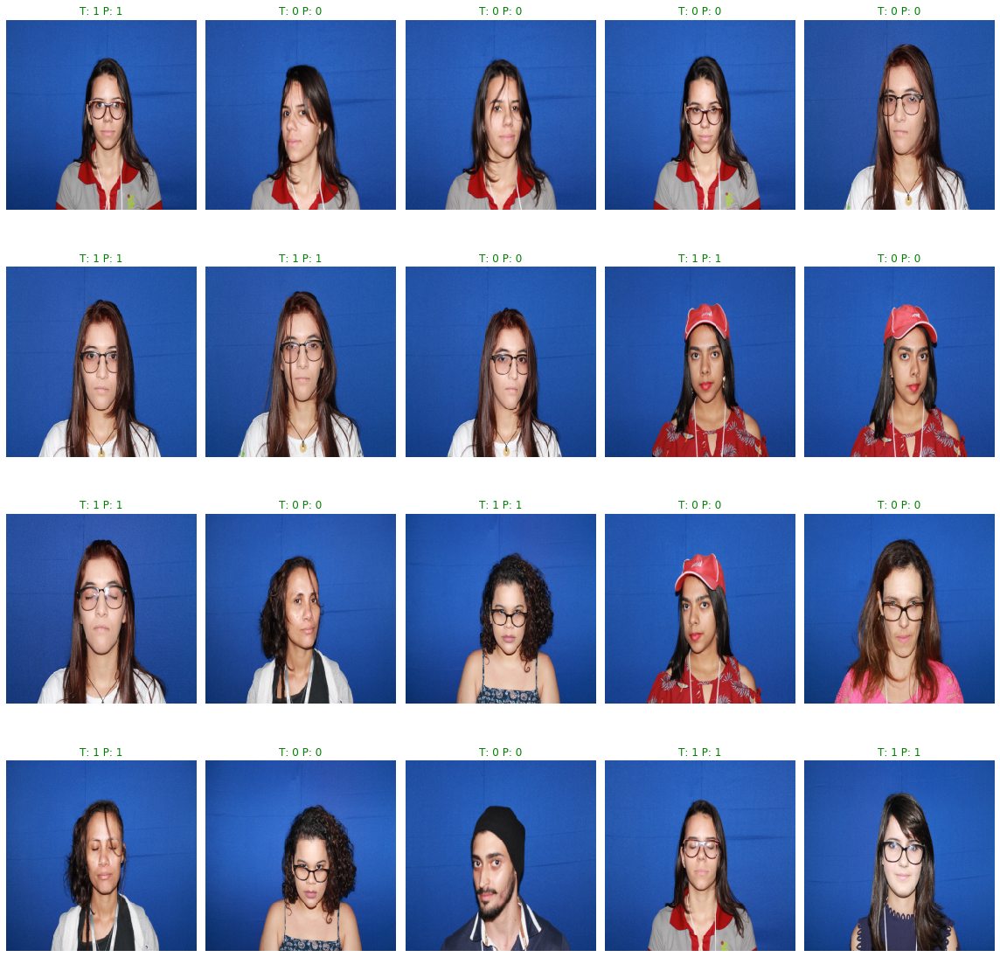

In [35]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Flash Reflection on Skin 

(5763,)
(array([0, 1]), array([2620, 3143], dtype=int64))


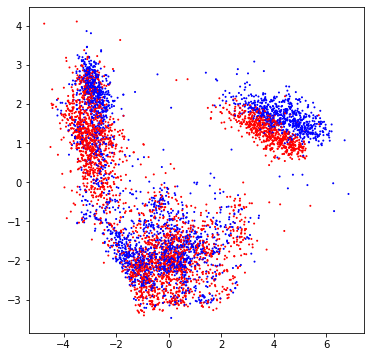

In [47]:
y = np.array([mrk.photo_reqs.flash_reflection_on_skin.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [691]


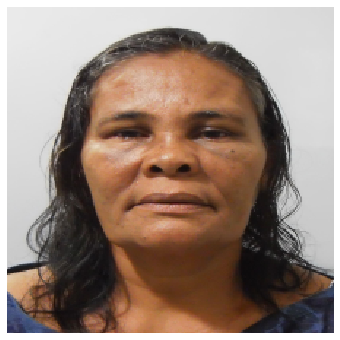

In [48]:
img_ref = get_reference_image(x, y)

[1.49133955 1.70259496 1.75096146 1.76864578 1.89232364 1.96725736
 1.97339817 1.98314725 1.99081453 2.01717802 2.03470382 2.03733143
 2.06227512 2.06309669 2.06371262 2.07193089 2.08243976 2.09670715
 2.09988779 2.11192144]


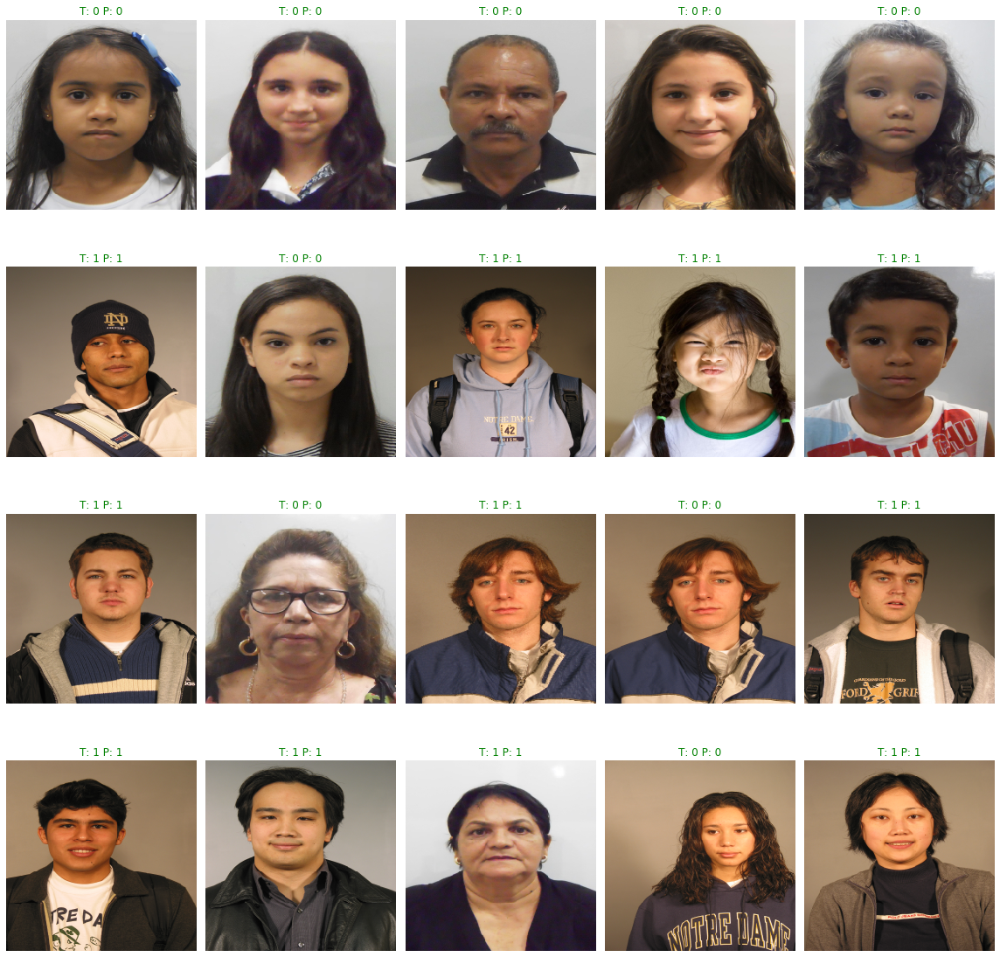

In [49]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Red Eyes

(5763,)
(array([0, 1]), array([1232, 4531], dtype=int64))


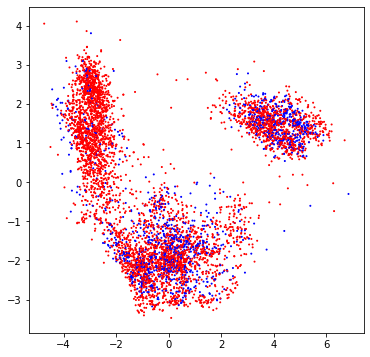

In [47]:
y = np.array([mrk.photo_reqs.red_eyes.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

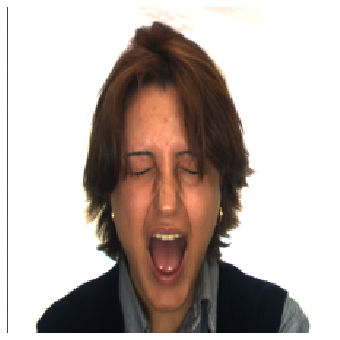

In [53]:
img_ref = get_reference_image(x, y)

[0.57630881 0.71201856 0.73585717 0.73586022 0.73586022 0.74751829
 0.7479054  0.75047744 0.79365734 0.80607618 0.80791166 0.81111534
 0.81111534 0.81602835 0.81619947 0.81686269 0.81686269 0.81943623
 0.81943623 0.82259731]


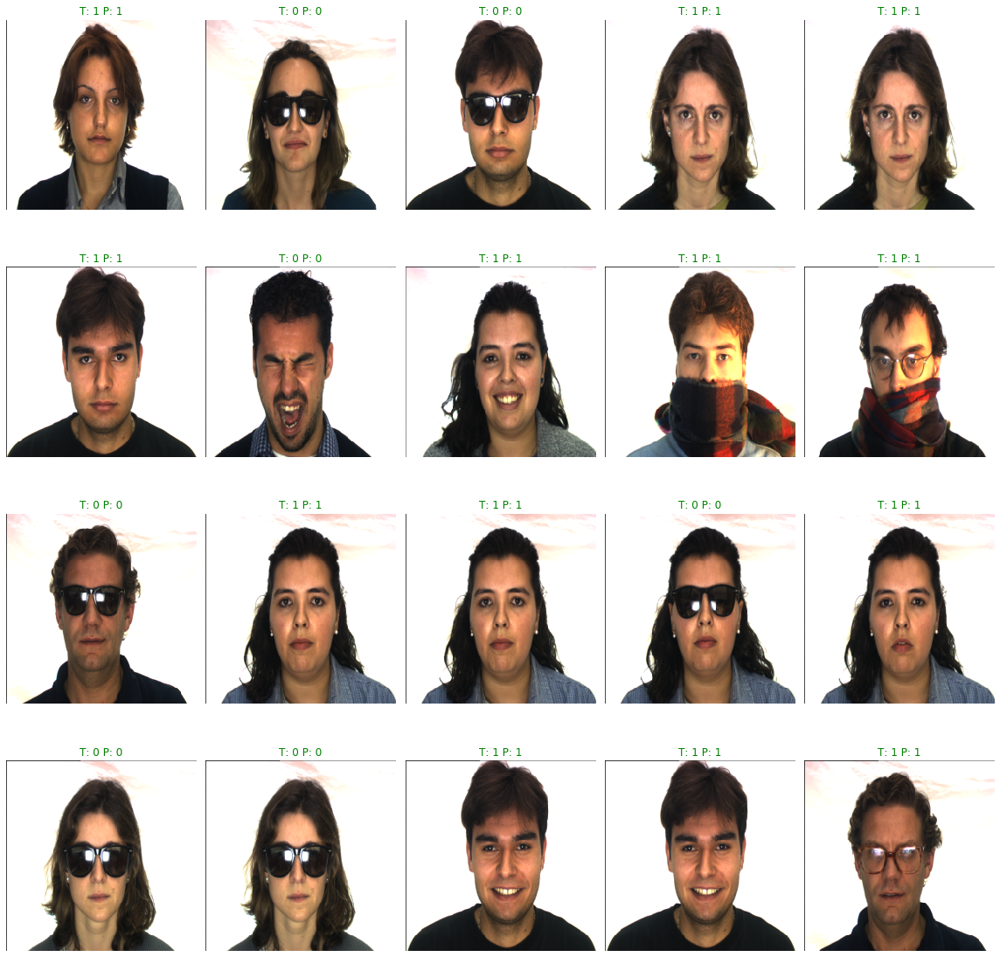

In [54]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Shadows Behind Head 

(5763,)
(array([0, 1]), array([1897, 3866], dtype=int64))


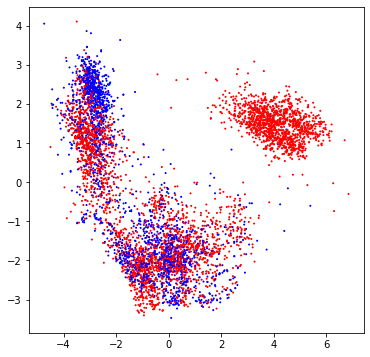

In [50]:
y = np.array([mrk.photo_reqs.shadows_behind_head.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [1687]


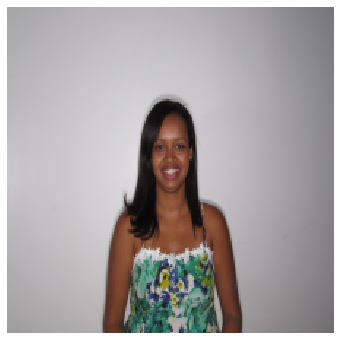

In [51]:
img_ref = get_reference_image(x, y)

[0.36120843 0.53920671 0.57097035 0.57271182 0.67481702 0.70091023
 0.70236281 0.71545392 0.7173716  0.73476496 0.74534935 0.77087605
 0.79203205 0.79770621 0.81851117 0.81867576 0.82378197 0.82788428
 0.83112356 0.83955253]


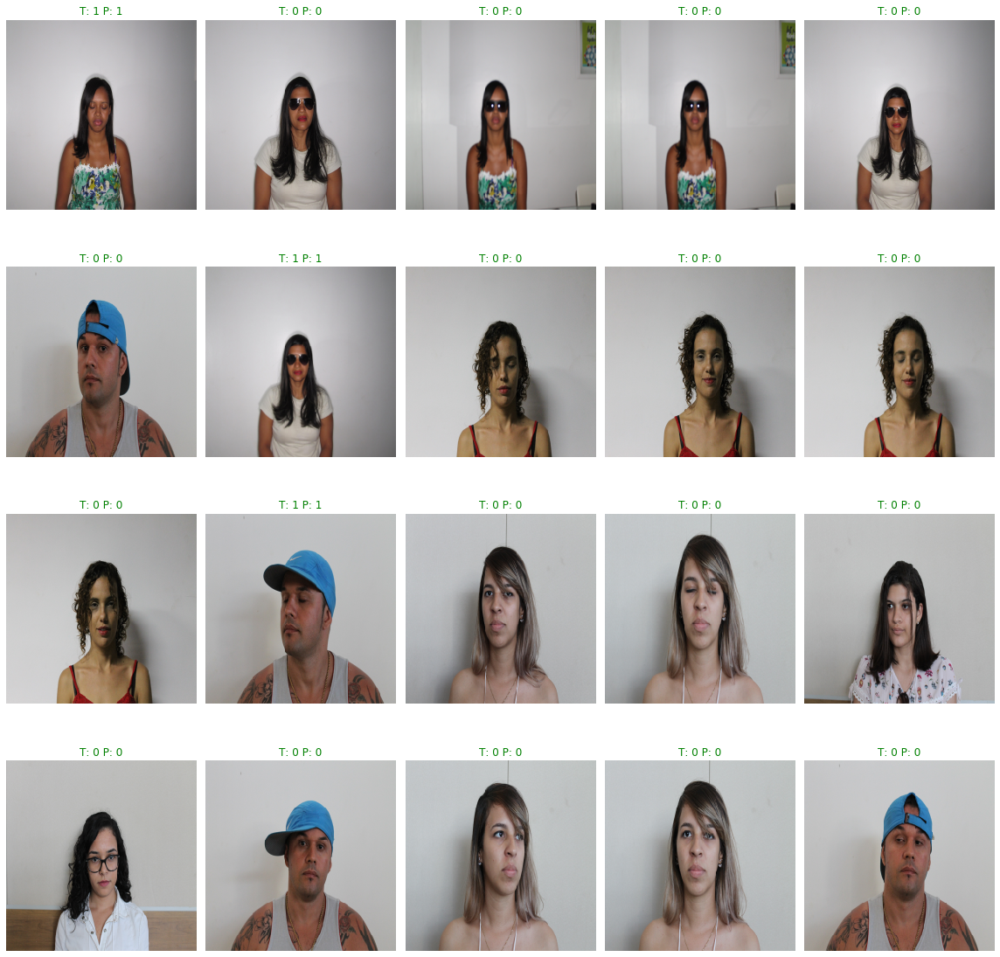

In [52]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Shadows Across Face

(5763,)
(array([0, 1]), array([1142, 4621], dtype=int64))


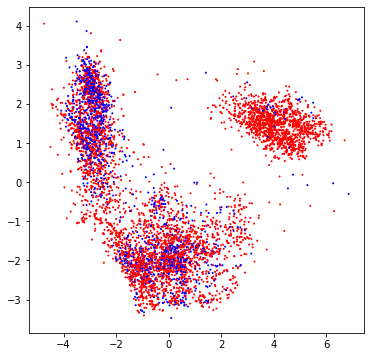

In [53]:
y = np.array([mrk.photo_reqs.shadows_across_face.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [895]


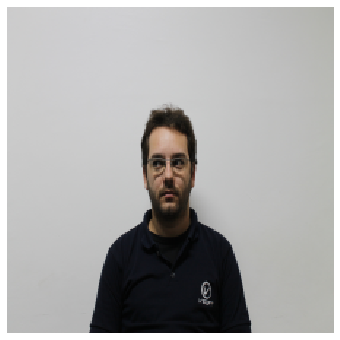

In [54]:
img_ref = get_reference_image(x, y)

[0.19282047 0.19844231 0.21777968 0.3482944  0.36723254 0.44972948
 0.45656054 0.46154248 0.50028893 0.51536752 0.52334837 0.52459576
 0.54732877 0.54915974 0.56720854 0.57058825 0.58938339 0.58960747
 0.59182547 0.60005507]


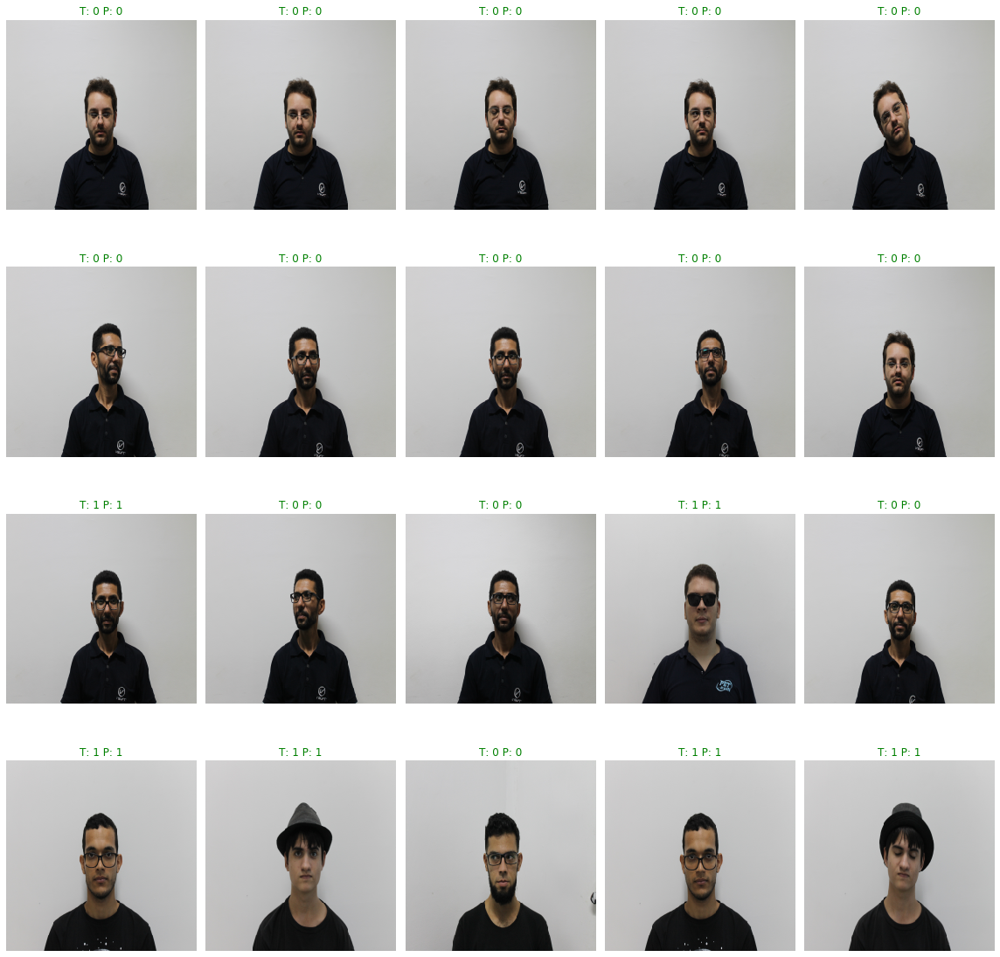

In [55]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Dark Tinted Lenses

(5763,)
(array([0, 1]), array([ 642, 5121], dtype=int64))


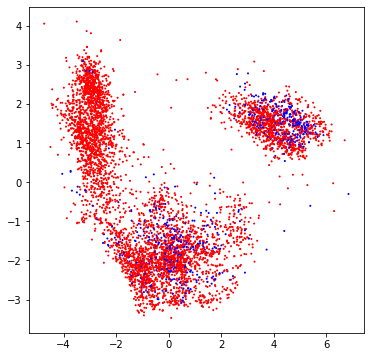

In [56]:
y = np.array([mrk.photo_reqs.dark_tinted_lenses.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [543]


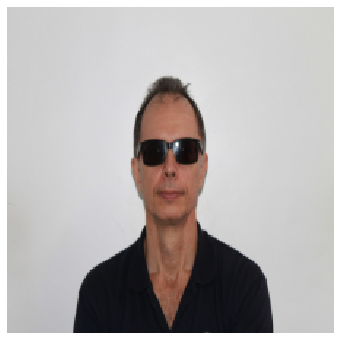

In [57]:
img_ref = get_reference_image(x, y)

[0.32934212 0.40965584 0.44493041 0.4864721  0.50049129 0.50259022
 0.56389271 0.61241892 0.62007811 0.62091628 0.62387565 0.62666542
 0.63106116 0.63136866 0.64026983 0.64142118 0.64659017 0.64925662
 0.66318426 0.66543068]


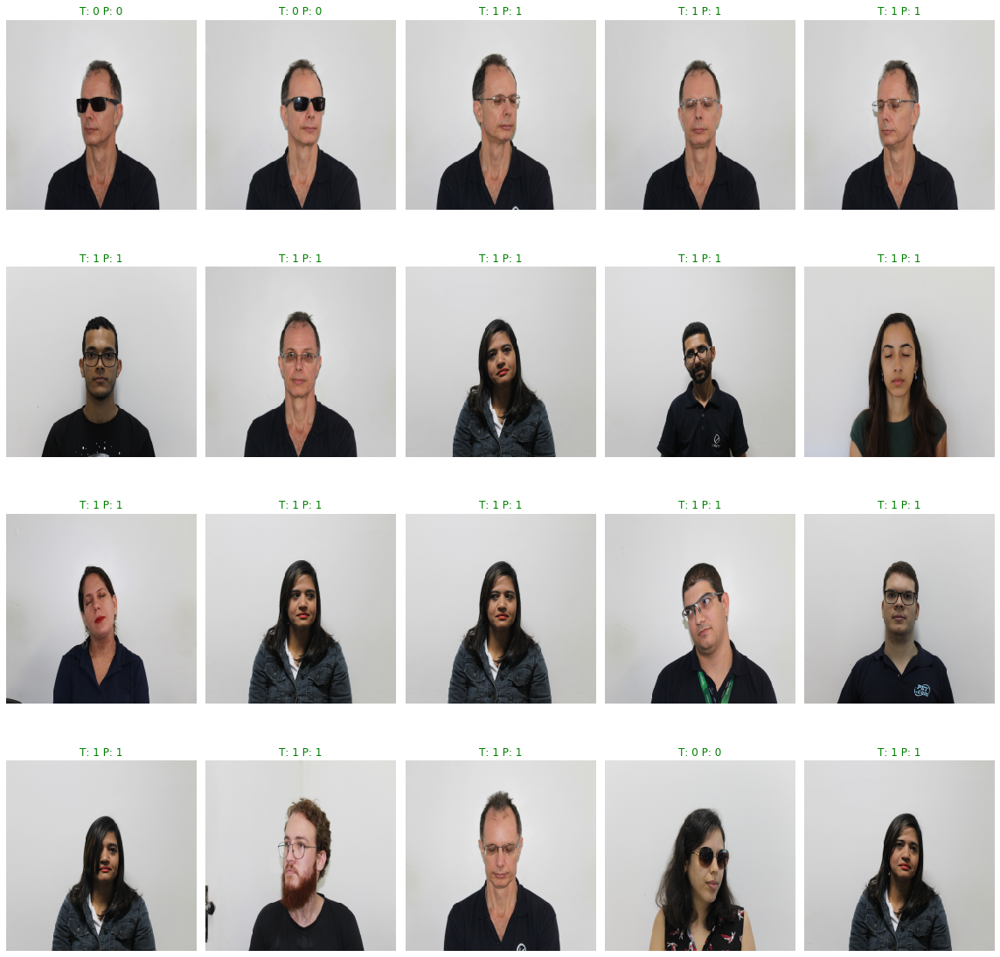

In [58]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Flash Reflection on Lenses 

(5763,)
(array([0, 1]), array([1179, 4584], dtype=int64))


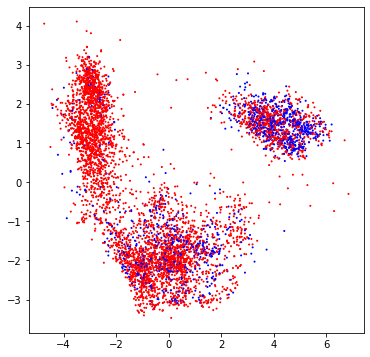

In [59]:
y = np.array([mrk.photo_reqs.flash_reflection_on_lenses.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [435]


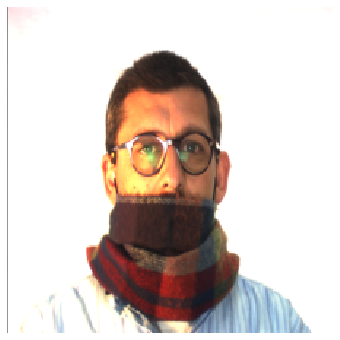

In [60]:
img_ref = get_reference_image(x, y)

[0.70123202 0.72889661 0.74147764 0.75027753 0.75140976 0.75530699
 0.75701225 0.75885487 0.76867739 0.77280016 0.77704454 0.77772872
 0.77813557 0.7828546  0.7828546  0.78723188 0.79888236 0.80404608
 0.80571391 0.8061621 ]


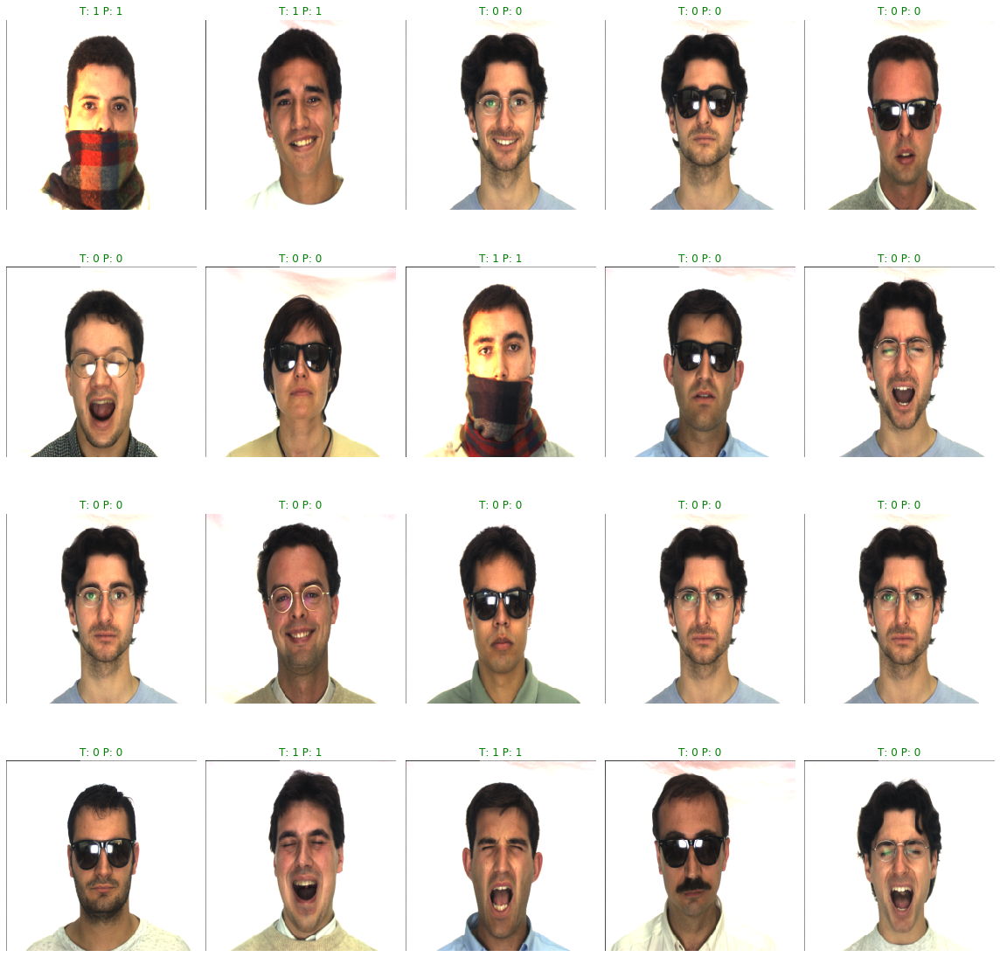

In [61]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Frames Too Heavy

one of the worst results

(5763,)
(array([0, 1]), array([  17, 5746], dtype=int64))


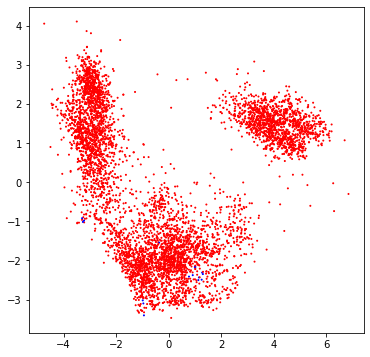

In [39]:
y = np.array([mrk.photo_reqs.frames_too_heavy.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

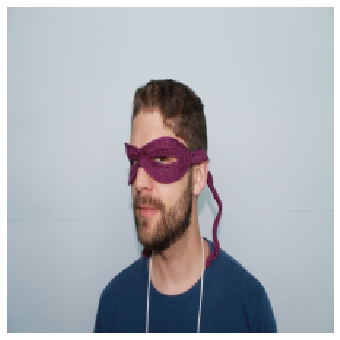

In [40]:
img_ref = get_reference_image(x, y)

[0.44373002 0.62297462 0.67698788 0.70919239 0.73074853 0.7374162
 0.75134118 0.86367352 0.87500528 1.00577786 1.05140664 1.0720154
 1.08016781 1.08228464 1.08482088 1.09093125 1.09144081 1.09281518
 1.09321344 1.10531904]


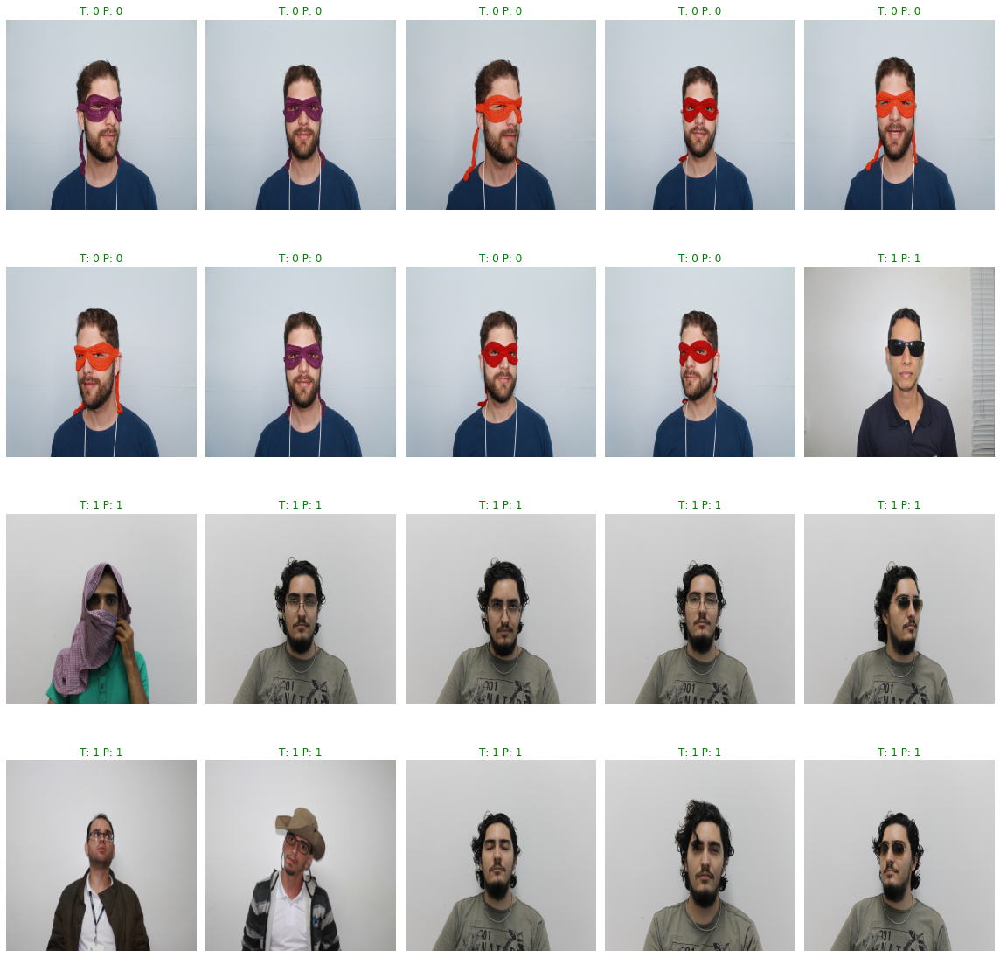

In [41]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Frame Covering Eyes

one of the worst results

(5763,)
(array([0, 1]), array([1679, 4084], dtype=int64))


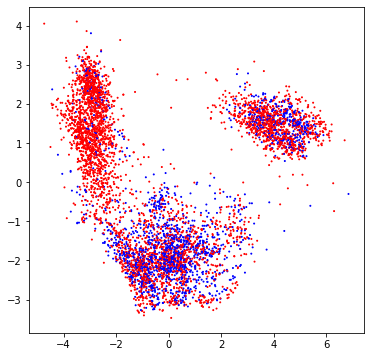

In [62]:
y = np.array([mrk.photo_reqs.frame_covering_eyes.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [1099]


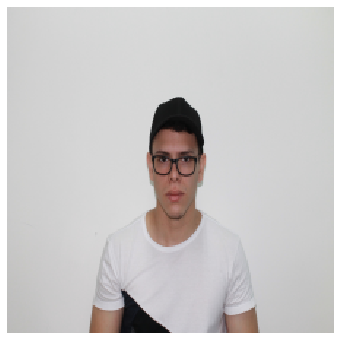

In [63]:
img_ref = get_reference_image(x, y)

[0.3419776  0.35454502 0.3555374  0.45744125 0.54709855 0.55527088
 0.56035648 0.59660677 0.60521944 0.60602428 0.68722885 0.70627073
 0.70805891 0.7496036  0.76442564 0.76536487 0.78904531 0.79626128
 0.80563198 0.82750223]


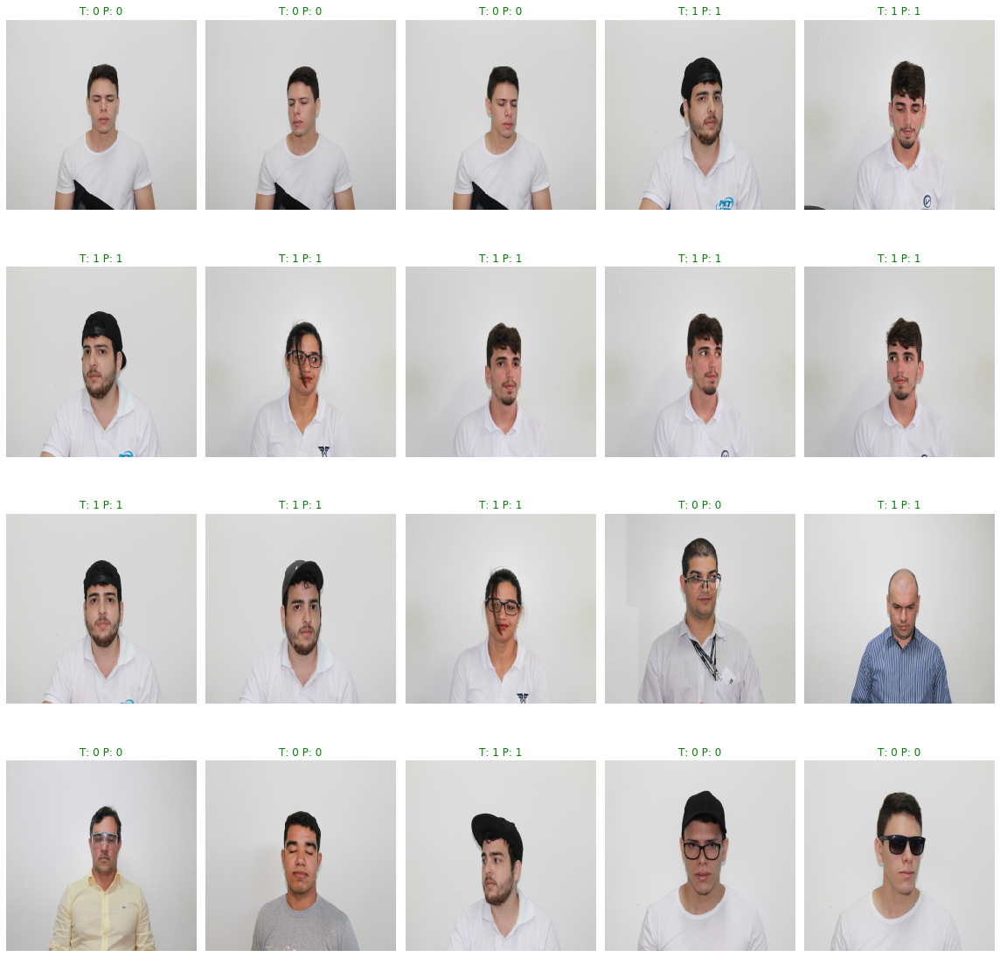

In [64]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Hat/Cap 

(5763,)
(array([0, 1]), array([ 849, 4914], dtype=int64))


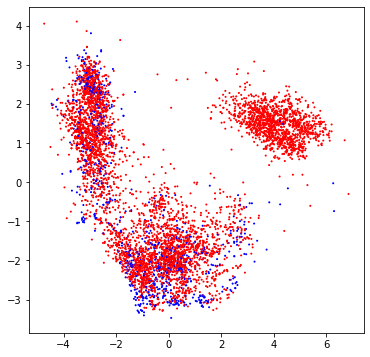

In [23]:
y = np.array([mrk.photo_reqs.hat_cap.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

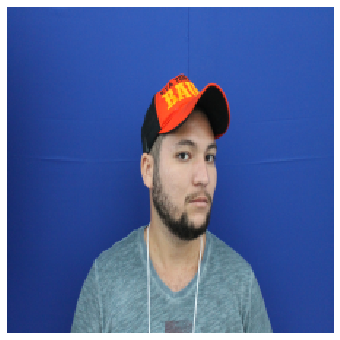

In [28]:
img_ref = get_reference_image(x, y)

[0.39240599 0.52948284 0.55900368 0.61507728 0.65418652 0.71513883
 0.72045703 0.79356406 0.95341678 0.99463689 1.00187448 1.00765628
 1.03308353 1.041126   1.05078953 1.05528493 1.07389922 1.07605894
 1.08785623 1.09058748]


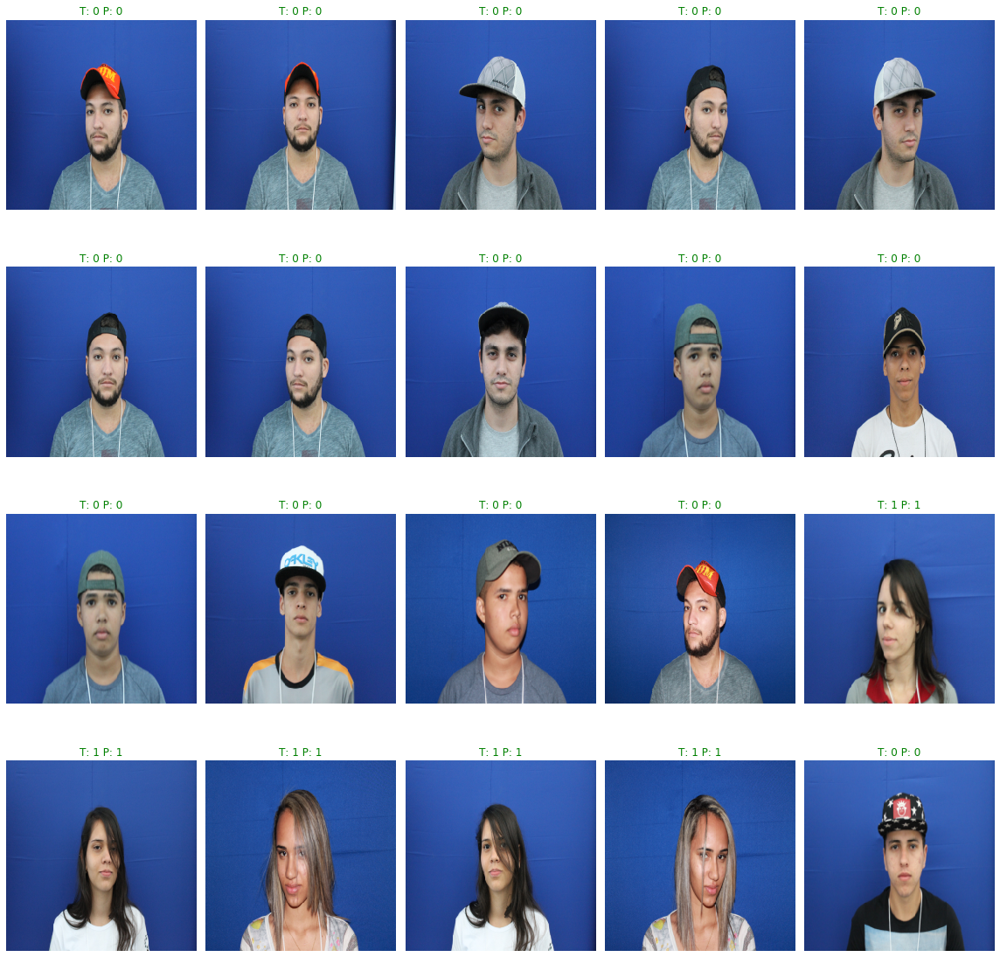

In [29]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Veil Over Face

one of the best results

(5763,)
(array([0, 1]), array([ 364, 5399], dtype=int64))


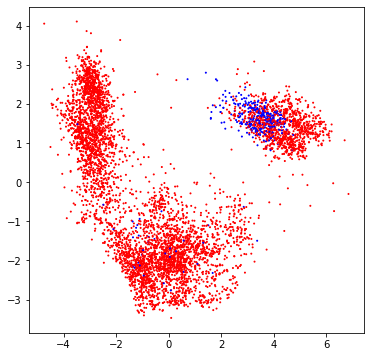

In [11]:
y = np.array([mrk.photo_reqs.veil_over_face.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

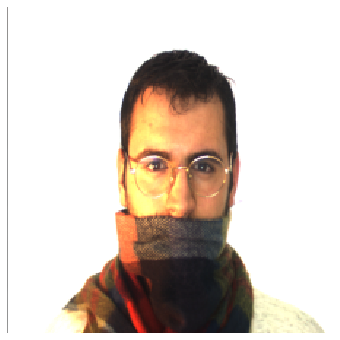

In [12]:
img_ref = get_reference_image(x, y)

[0.64324632 0.6508167  0.68285851 0.69488304 0.72446842 0.72473736
 0.72703303 0.73118921 0.74372824 0.74959297 0.75727129 0.76294356
 0.76719085 0.79425112 0.80049511 0.80877935 0.81412207 0.81653136
 0.82465623 0.82970535]


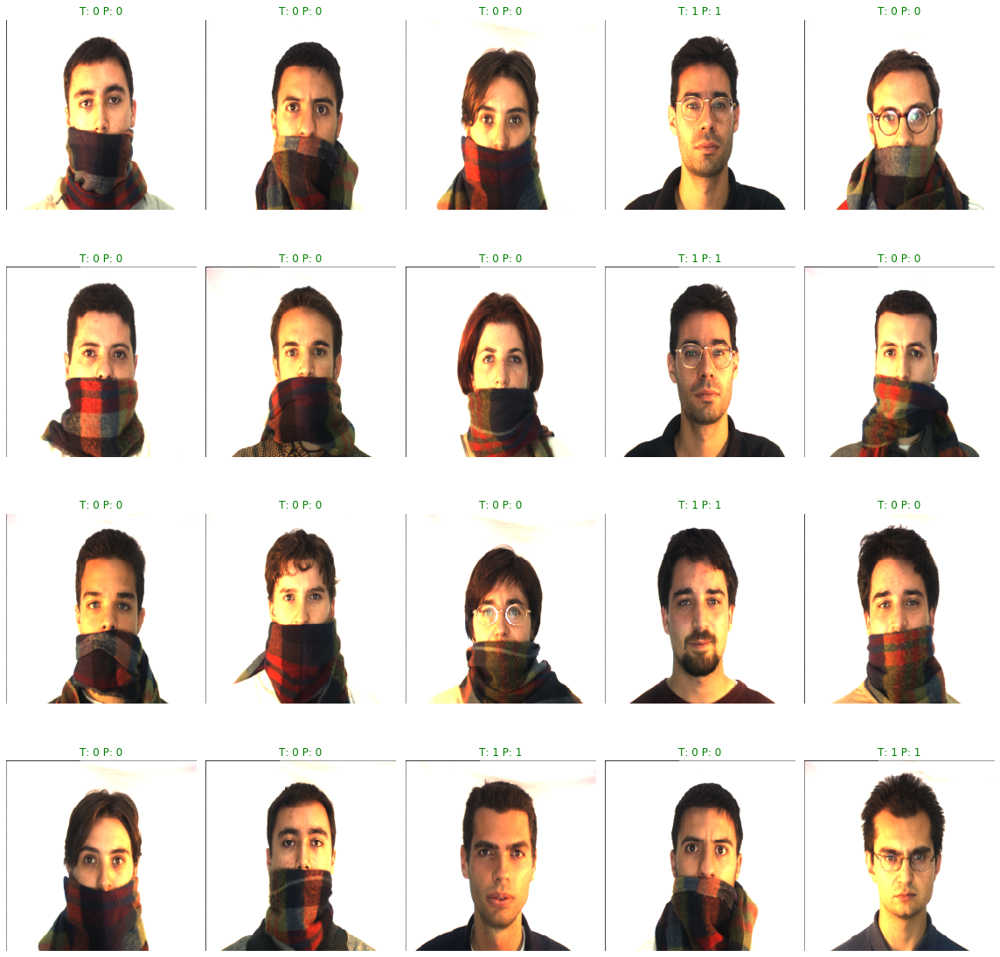

In [13]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Mouth Open 

(5763,)
(array([0, 1]), array([1532, 4231], dtype=int64))


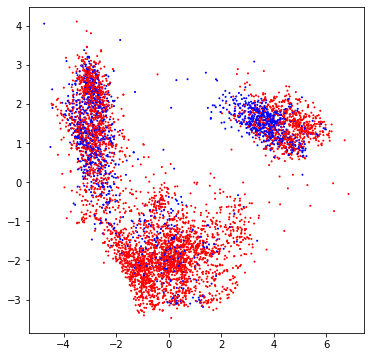

In [68]:
y = np.array([mrk.photo_reqs.mouth_open.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

random index: [182]


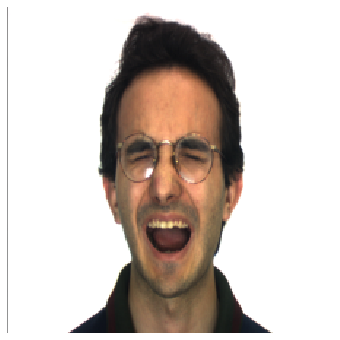

In [69]:
img_ref = get_reference_image(x, y)

[0.41362752 0.46939891 0.48789625 0.58800422 0.60160685 0.60160685
 0.63504975 0.65204901 0.67513019 0.68554654 0.69530997 0.69731732
 0.71635616 0.72068538 0.72164447 0.72493038 0.72914296 0.73239245
 0.73455962 0.73749766]


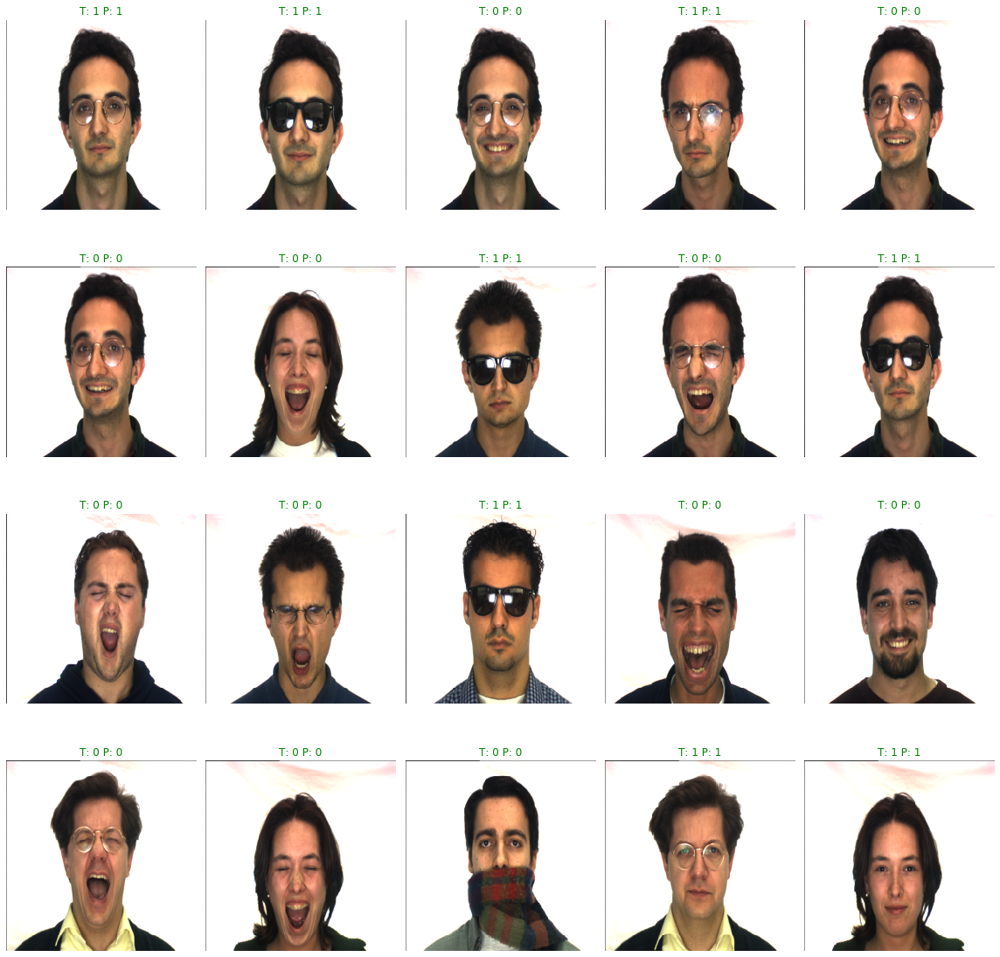

In [70]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))

## Presence of Other Faces or Toys 

(5763,)
(array([0, 1]), array([  70, 5693], dtype=int64))


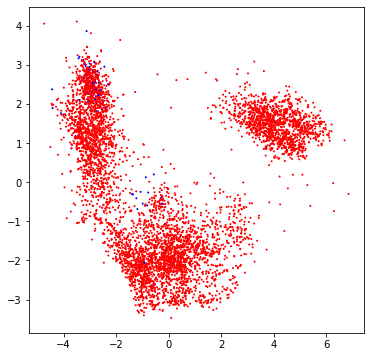

In [42]:
y = np.array([mrk.photo_reqs.presence_of_other_faces_or_toys.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

plot_pca(emb_2d, y)

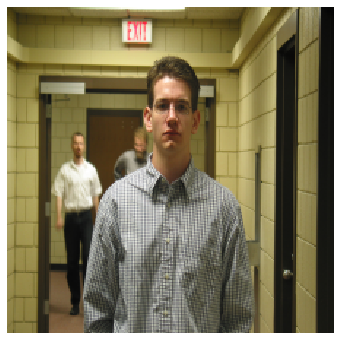

In [45]:
img_ref = get_reference_image(x, y)

[0.57718021 1.00379773 1.07914612 1.09799629 1.10993059 1.15950539
 1.25057392 1.29904909 1.36605452 1.36962626 1.38958831 1.39102961
 1.39578025 1.41103114 1.41286976 1.41408159 1.41457714 1.4737278
 1.48563621 1.48619766]


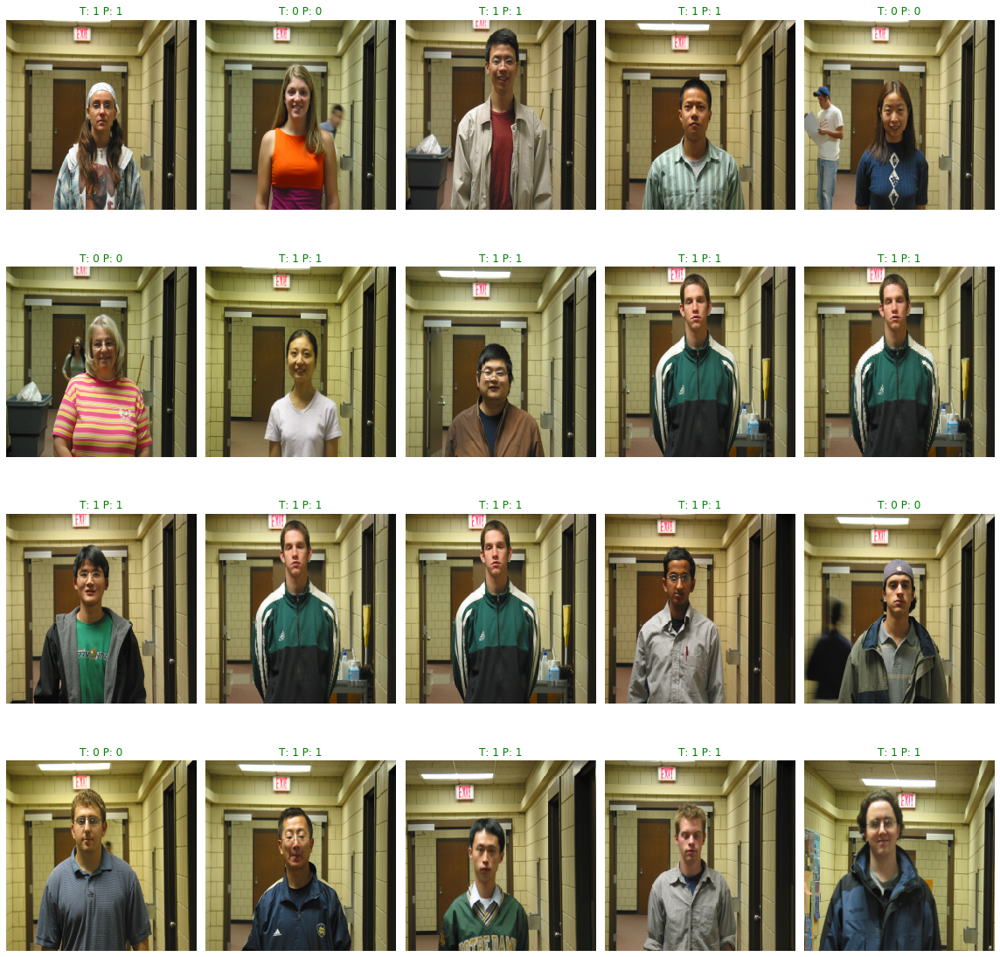

In [46]:
plot_closest_images(img_ref, encoder, x, y, embeddings, n_imgs=20, figsize=(16, 20))